**Part 1- Neural Network**

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 30.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 39.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 27.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 25.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 9.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 87.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling 

In [ ]:
!pip install mediapipe
#!pip install mediapipe --no-deps --no-cache-dir

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.6/35.6 MB 17.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 58.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.9/294.9 kB 24.1 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 5.29.5
    Uninstalling protobuf-5.29.5:
      Successfully uninstalled protobuf-5.29.5
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.26.4 which is incompatible.
ydf 0.12.0 requires protobuf<6.0.0,>=5.29.1, but you have protobuf 4.25.8 which is incompatible.
grpcio-

In [ ]:
import numpy as np
import os
import PIL
import PIL.Image
import tensorflow as tf
import tensorflow_datasets as tfds
import pathlib
import matplotlib.pyplot as plt
import keras.datasets.fashion_mnist as fashion_mnist
import cv2
import imutils
from google.colab.patches import cv2_imshow
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode
import mediapipe as mp

import urllib.request
from ultralytics import YOLO
import ipywidgets as widgets

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
# This part ran on CPU
import tensorflow as tf
import matplotlib.pyplot as plt
import keras.datasets.fashion_mnist as fashion_mnist

29515/29515 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
26421880/26421880 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
5148/5148 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
4422102/4422102 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


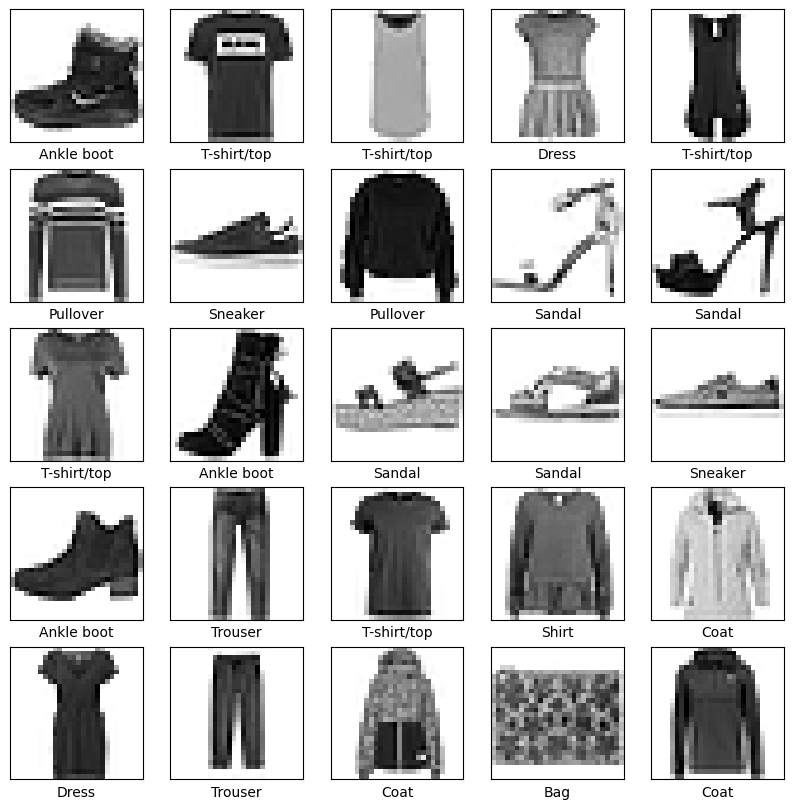

In [ ]:
(X_train, y_train), (X_test, y_test) = fashion_mnist.load_data()   #Load the dataset here
class_names = ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat',
               'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']   #These are the labels


# plot following graph in gray scale
# Write your code here
plt.figure(figsize=(10,10))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(X_train[i], cmap=plt.cm.binary)
    plt.xlabel(class_names[y_train[i]])
plt.show()

In [ ]:
# normalize inputs from 0-255 to 0-1
X_train = X_train / 255
X_test = X_test / 255


In [ ]:
#Create the model here. It should be an NN model with one hiddenlayer (128 nodes) and Relu activation function. What should be the output activation function?
model = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(28, 28)),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(10)
])
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [ ]:
# Train the model here
hist = model.fit(X_train, y_train, validation_split= 0.2, epochs=20)

Epoch 1/20
1500/1500 ━━━━━━━━━━━━━━━━━━━━ 10s 6ms/step - accuracy: 0.2269 - loss: 2.4992 - val_accuracy: 0.2403 - val_loss: 2.3026
Epoch 2/20
1500/1500 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - accuracy: 0.2502 - loss: 2.3026 - val_accuracy: 0.2403 - val_loss: 2.3026
Epoch 3/20
1500/1500 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - accuracy: 0.2480 - loss: 2.3026 - val_accuracy: 0.2403 - val_loss: 2.3026
Epoch 4/20
1500/1500 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.2505 - loss: 2.3026 - val_accuracy: 0.2403 - val_loss: 2.3026
Epoch 5/20
1500/1500 ━━━━━━━━━━━━━━━━━━━━ 11s 4ms/step - accuracy: 0.2530 - loss: 2.3026 - val_accuracy: 0.2403 - val_loss: 2.3026
Epoch 6/20
1500/1500 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.2504 - loss: 2.3026 - val_accuracy: 0.2403 - val_loss: 2.3026
Epoch 7/20
1500/1500 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - accuracy: 0.2499 - loss: 2.3026 - val_accuracy: 0.2403 - val_loss: 2.3026
Epoch 8/20
1500/1500 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - accuracy: 0.2502 - loss: 2.3026

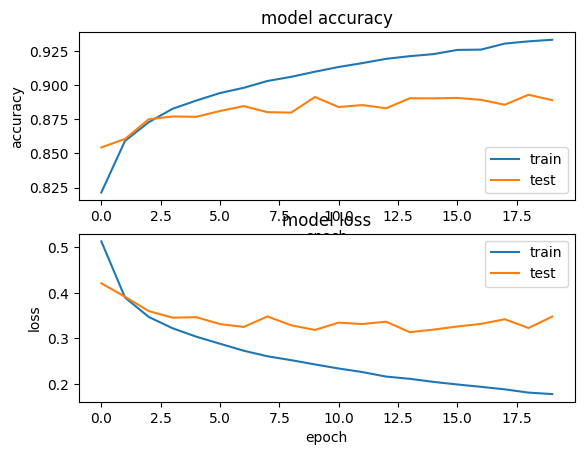

In [ ]:
# draw the learning curve here
plt.subplot(2,1,1)
plt.plot(hist.history['accuracy'])
plt.plot(hist.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='lower right')

plt.subplot(2,1,2)
plt.plot(hist.history['loss'])
plt.plot(hist.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper right')

plt.show()

**Part 2- Image Processing**

Load the Flower photo dataset from tensorflow repository

In [ ]:
dataset_url = "https://storage.googleapis.com/download.tensorflow.org/example_images/flower_photos.tgz"
data_dir = tf.keras.utils.get_file(origin=dataset_url,
                                   fname='flower_photos',
                                   untar=True)
data_dir = pathlib.Path(data_dir)

228813984/228813984 [==============================] - 2s 0us/step


*a) How many images we can find in this dataset?*




In [ ]:
image_count = len(list(data_dir.glob('*/*.jpg')))  #This will count all the file with extension of jpg
print(image_count)

3670


*b) The list of subfolders are:*
*   daisy
*   dandelion
*   roses
*   sunflowers
*   tulips

You can look into any of the subfolders to see images stored over there. You can look into the folder using: data_dir.glob('tulips/*')
For this part use Pillow (PIL) to show at least one flower from each subfolder


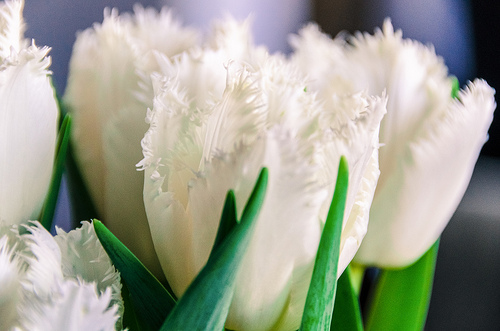

In [ ]:
tulips = list(data_dir.glob('tulips/*'))    #This line stores the list of data in subfolder
PIL.Image.open(str(tulips[2]))              # Use Pillow here to plot the image


*c) Use Keras to resize all the images into same dimension 180x180*

In [ ]:
batch_size = 32
img_height = 180
img_width = 180

In [ ]:
# Convert all the images in data_dir folder into 180x180 using tf.kera.utils.image_dataset_from_directory
# Modify following code
train_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="training",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 3670 files belonging to 5 classes.
Using 2936 files for training.


In [ ]:
# Use the same strategy to create validation data, this time from validation subset
val_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="validation",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)


Found 3670 files belonging to 5 classes.
Using 734 files for validation.


d) *You can use* `train_ds.class_names` *command to get the list of labels. Write a code to randomly show 9 images from training data while printing their label on top of the image.*

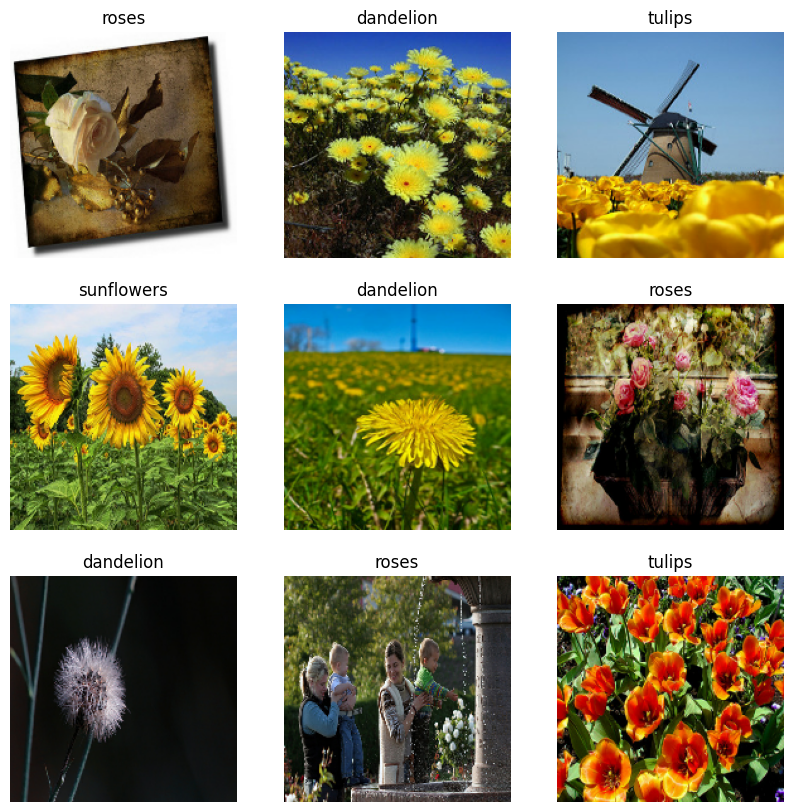

In [ ]:
class_names = train_ds.class_names
plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

**2- OPENCV**- Now use opencv for preprocessing. Show first 9 images in dataset using Opencv. Before showing each image, resize the images to 180x180.

<Figure size 1000x1000 with 0 Axes>

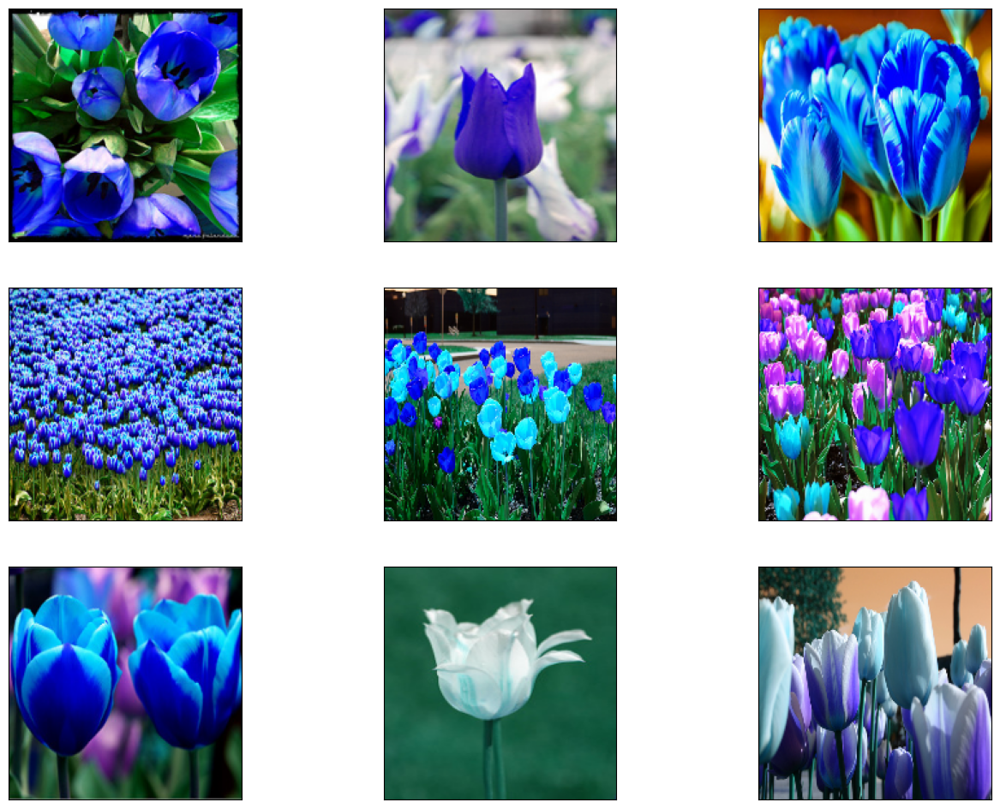

In [ ]:
# Repeat same preprocessing but this time using OpenCV. Show first 9 images in dataset using Opencv. Before showing each image, resize the images to 180x180.
import cv2
list_of_images= list(data_dir.glob('*/*.jpg'))
class_names = train_ds.class_names
plt.figure(figsize=(10, 10))
fig=plt.figure(figsize=(16, 12))

for i in range(9):
    y = plt.subplot(3, 3, i + 1)
    img = cv2.imread(str(list_of_images[i]))
    y.imshow(img)
    img = cv2.resize(img,(180,180))
    #img= cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    y.imshow(img)
    y.axes.get_xaxis().set_visible(False)
    y.axes.get_yaxis().set_visible(False)


plt.show()


OpenCV uses BGR as its default colour order for images, matplotlib uses RGB. When you display an image loaded with OpenCv in matplotlib the channels will be back to front.
The easiest way of fixing this is to use OpenCV to explicitly convert it back to RGB, much like you do when creating the greyscale image.
`RGB_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)`

<Figure size 1000x1000 with 0 Axes>

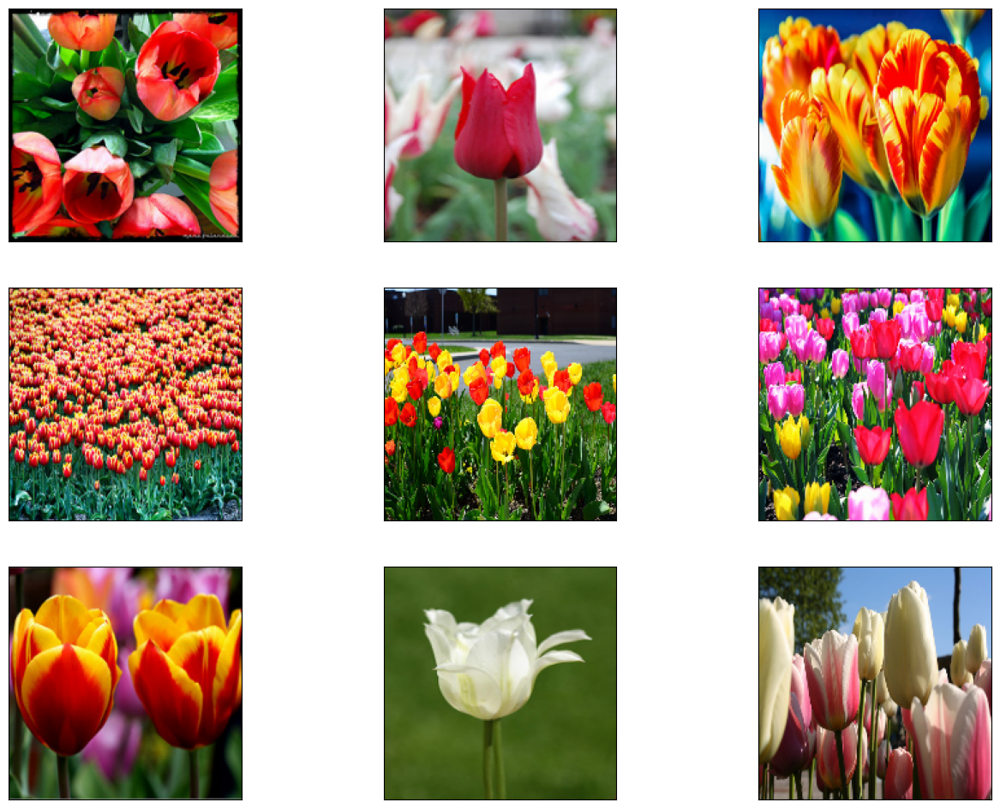

In [ ]:
import cv2
list_of_images= list(data_dir.glob('*/*.jpg'))
class_names = train_ds.class_names
plt.figure(figsize=(10, 10))
fig=plt.figure(figsize=(16, 12))

for i in range(9):
    y = plt.subplot(3, 3, i + 1)
    img = cv2.imread(str(list_of_images[i]))
    y.imshow(img)
    img = cv2.resize(img,(180,180))
    img= cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    y.imshow(img)
    y.axes.get_xaxis().set_visible(False)
    y.axes.get_yaxis().set_visible(False)


plt.show()


In [ ]:
(X_train, y_train), (X_test, y_test) = cifar10.load_data()
labels= ["airplane","automobile","bird","cat","deer","dog","frog","horse","ship","truck"]
print(X_train.shape)
print(X_test.shape)

170498071/170498071 [==============================] - 12s 0us/step
(50000, 32, 32, 3)
(10000, 32, 32, 3)


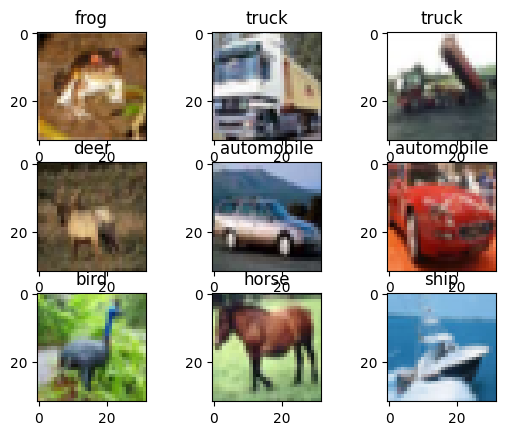

In [ ]:
# 2.a. Let's look into the dataset by visualizing some data opints
for i in range(9):
  plt.subplot(3,3,i+1)
  plt.imshow(X_train[i], cmap=plt.get_cmap('gray'))
  plt.title(labels[y_train[i][0]])

# show the plot
plt.show()

2.b. Apply the pre-processing algorithms that we discussed last week. The augmented images are supposed to be seared by 20%, zoomed by 20% and horizontally flipped. Now, design a CNN model with 4 convolution layers in which two of them have 32 and two of them have 64 filters. The fully connected layer has two hidden layers (512 and 256 nodes respectively). Draw the Learning curve. What is your understanding from learning curve?

In [ ]:
# 2.b
# Encoding output
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

# create data generator
datagen = ImageDataGenerator(rescale = 1./255, shear_range = 0.2, zoom_range = 0.2, horizontal_flip=True)
# prepare iterator
it_train = datagen.flow(X_train, y_train, batch_size=64)

model = Sequential()

model.add(Conv2D(32, (3, 3), input_shape=(32,32,3), activation='relu'))
model.add(Conv2D(32, (3, 3), activation='relu'))

model.add(MaxPooling2D(pool_size=(2,2)))
BatchNormalization(axis=-1)
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))

model.add(Flatten())
# Fully connected layer
model.add(Dense(512, activation='relu'))
BatchNormalization()
model.add(Dense(256, activation='relu'))
model.add(Dense(10, activation='softmax'))


model.compile(loss='categorical_crossentropy', optimizer='adam',  metrics=['accuracy'])
hist = model.fit(it_train.x, it_train.y, batch_size=128, epochs=20,  validation_split=0.2)

Epoch 1/20
313/313 [==============================] - 8s 14ms/step - loss: 1.8244 - accuracy: 0.3857 - val_loss: 1.4234 - val_accuracy: 0.4870
Epoch 2/20
313/313 [==============================] - 3s 9ms/step - loss: 1.3178 - accuracy: 0.5297 - val_loss: 1.2195 - val_accuracy: 0.5650
Epoch 3/20
313/313 [==============================] - 3s 10ms/step - loss: 1.1261 - accuracy: 0.6006 - val_loss: 1.1707 - val_accuracy: 0.5875
Epoch 4/20
313/313 [==============================] - 3s 11ms/step - loss: 0.9509 - accuracy: 0.6641 - val_loss: 1.1540 - val_accuracy: 0.6016
Epoch 5/20
313/313 [==============================] - 3s 9ms/step - loss: 0.8031 - accuracy: 0.7187 - val_loss: 1.0936 - val_accuracy: 0.6331
Epoch 6/20
313/313 [==============================] - 3s 10ms/step - loss: 0.6642 - accuracy: 0.7658 - val_loss: 1.1617 - val_accuracy: 0.6238
Epoch 7/20
313/313 [==============================] - 3s 9ms/step - loss: 0.5184 - accuracy: 0.8195 - val_loss: 1.2541 - val_accuracy: 0.6187
Ep

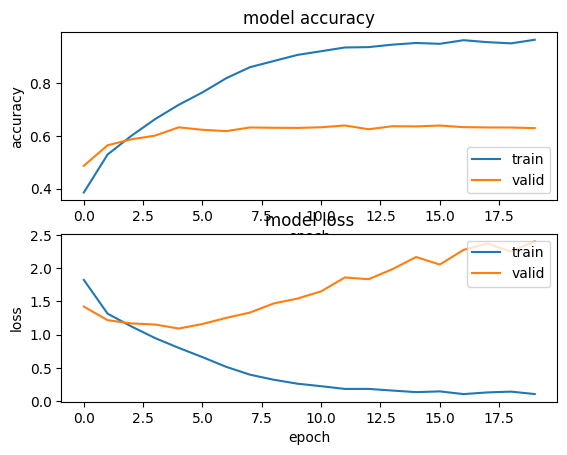

In [ ]:
# Draw learning curve here
learning_curve(hist)

In [ ]:
#2.c. Solution to resolve overfitting
# One solution is adding drop out
model = Sequential()

model.add(Conv2D(32, (3, 3), input_shape=(32,32,3), activation='relu'))
model.add(Dropout(0.2))
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(Dropout(0.2))

model.add(MaxPooling2D(pool_size=(2,2)))
BatchNormalization(axis=-1)
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(Dropout(0.2))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(Dropout(0.2))
model.add(MaxPooling2D(pool_size=(2,2)))

model.add(Flatten())
# Fully connected layer
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.2))
BatchNormalization()
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(10, activation='softmax'))


model.compile(loss='categorical_crossentropy', optimizer='adam',  metrics=['accuracy'])
hist = model.fit(it_train.x, it_train.y, batch_size=128, epochs=20,  validation_split=0.2)

Epoch 1/20
313/313 [==============================] - 8s 16ms/step - loss: 2.8159 - accuracy: 0.2404 - val_loss: 1.8056 - val_accuracy: 0.3534
Epoch 2/20
313/313 [==============================] - 4s 13ms/step - loss: 1.5987 - accuracy: 0.4145 - val_loss: 1.5152 - val_accuracy: 0.4806
Epoch 3/20
313/313 [==============================] - 4s 13ms/step - loss: 1.4209 - accuracy: 0.4881 - val_loss: 1.3624 - val_accuracy: 0.5458
Epoch 4/20
313/313 [==============================] - 5s 14ms/step - loss: 1.3059 - accuracy: 0.5337 - val_loss: 1.3302 - val_accuracy: 0.5596
Epoch 5/20
313/313 [==============================] - 4s 13ms/step - loss: 1.2088 - accuracy: 0.5712 - val_loss: 1.2540 - val_accuracy: 0.5869
Epoch 6/20
313/313 [==============================] - 5s 15ms/step - loss: 1.1298 - accuracy: 0.5989 - val_loss: 1.1422 - val_accuracy: 0.6192
Epoch 7/20
313/313 [==============================] - 4s 14ms/step - loss: 1.0674 - accuracy: 0.6222 - val_loss: 1.0919 - val_accuracy: 0.6498

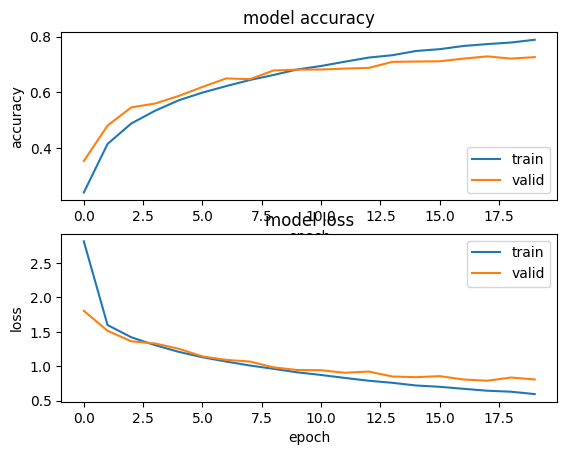

In [ ]:
# Draw learning curve
learning_curve(hist)

In [ ]:
# Implementing VGG16
from keras.applications.vgg16 import VGG16
from keras.preprocessing import image
from keras.applications.vgg16 import preprocess_input
from keras.models import Model
import numpy as np

vgg_model = VGG16(weights=None, include_top=True, input_shape=X_train.shape[1:], classes=10)
vgg_model.compile(optimizer=SGD(learning_rate=0.005, momentum=0.9, nesterov=True), loss='categorical_crossentropy', metrics=['accuracy'])
hist = vgg_model.fit(it_train.x, it_train.y, epochs=20, batch_size=256, verbose=1,validation_split=0.2)


Epoch 1/20
157/157 [==============================] - 30s 132ms/step - loss: 2.2462 - accuracy: 0.1497 - val_loss: 2.2506 - val_accuracy: 0.1581
Epoch 2/20
157/157 [==============================] - 17s 108ms/step - loss: 2.1155 - accuracy: 0.2124 - val_loss: 1.8977 - val_accuracy: 0.3052
Epoch 3/20
157/157 [==============================] - 17s 106ms/step - loss: 1.7088 - accuracy: 0.3780 - val_loss: 1.5996 - val_accuracy: 0.4041
Epoch 4/20
157/157 [==============================] - 17s 106ms/step - loss: 1.4660 - accuracy: 0.4685 - val_loss: 1.6310 - val_accuracy: 0.4028
Epoch 5/20
157/157 [==============================] - 17s 108ms/step - loss: 1.3014 - accuracy: 0.5365 - val_loss: 1.3028 - val_accuracy: 0.5260
Epoch 6/20
157/157 [==============================] - 17s 108ms/step - loss: 1.1502 - accuracy: 0.5896 - val_loss: 1.1844 - val_accuracy: 0.5819
Epoch 7/20
157/157 [==============================] - 17s 109ms/step - loss: 1.0227 - accuracy: 0.6359 - val_loss: 1.1024 - val_ac

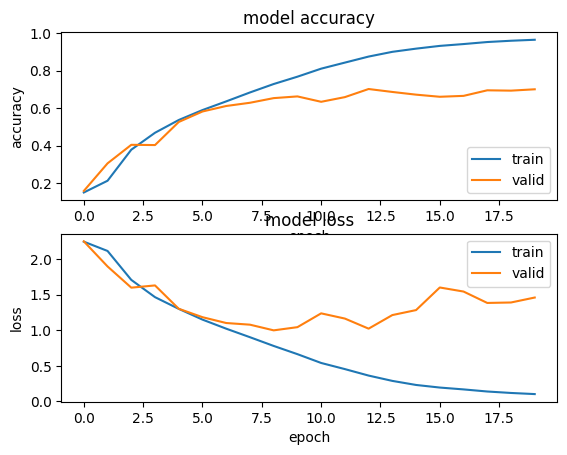

In [ ]:
learning_curve(hist)

In [ ]:
vgg_model.evaluate(X_test, y_test, batch_size=256, verbose=1)

40/40 [==============================] - 1s 29ms/step - loss: 1.5175 - accuracy: 0.6959


[1.5175414085388184, 0.695900022983551]

# Object Detection using YOLO

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 29.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 80.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 68.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 51.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 99.6 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling 

In [ ]:
from ultralytics import YOLO
model = YOLO("yolov8n.pt")
results = model("https://psni.org/wp-content/uploads/2017/11/coferenceroom2.png", show=True)


WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()


Found https://psni.org/wp-content/uploads/2017/11/coferenceroom2.png locally at coferenceroom2.png
image 1/1 /content/coferenceroom2.png: 384x640 1 bench, 6 chairs, 2 dining tables, 1 tv, 92.1ms
Speed: 4.1ms preprocess, 92.1ms inference, 232.6ms postprocess per image at shape (1, 3, 384, 640)


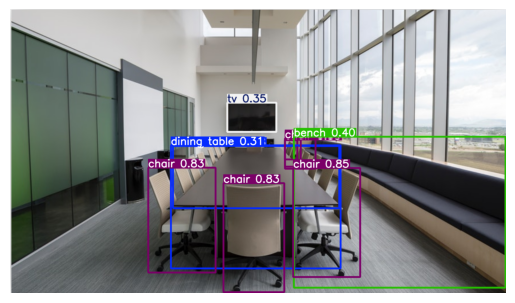

In [ ]:
img = results[0].plot()  # returns numpy array
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


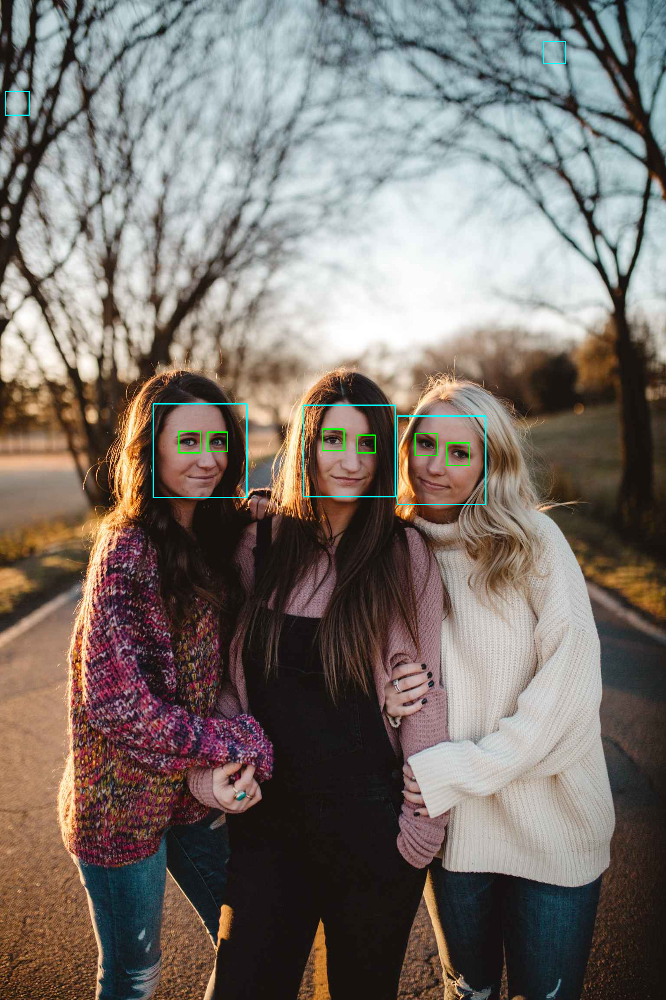

In [ ]:
# Face Recognition
face_cascade = cv2.CascadeClassifier("/content/drive/MyDrive/Meta/haarcascade_frontalface_default.xml")
eye_cascade = cv2.CascadeClassifier("/content/drive/MyDrive/Meta/haarcascade_eye.xml")

img = cv2.imread("/content/drive/MyDrive/Meta/Assignment4_pic2.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
faces = face_cascade.detectMultiScale(gray, 1.3, 5)

for (x,y,w,h) in faces:
    img1 = cv2.rectangle(img,(x, y),(x + w, y + h),(255,255,0),2)
    roi_gray = gray[y: y + h, x: x + w]
    roi_color = img[y: y + h, x: x + w]
    eyes = eye_cascade.detectMultiScale(roi_gray)
    for (ex, ey, ew, eh) in eyes:
        cv2.rectangle(roi_color,(ex, ey), (ex + ew, ey + eh), (0,255,0),2)

cv2_imshow(img)

In [ ]:
#Function to activate your laptop cam
def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

<IPython.core.display.Javascript object>

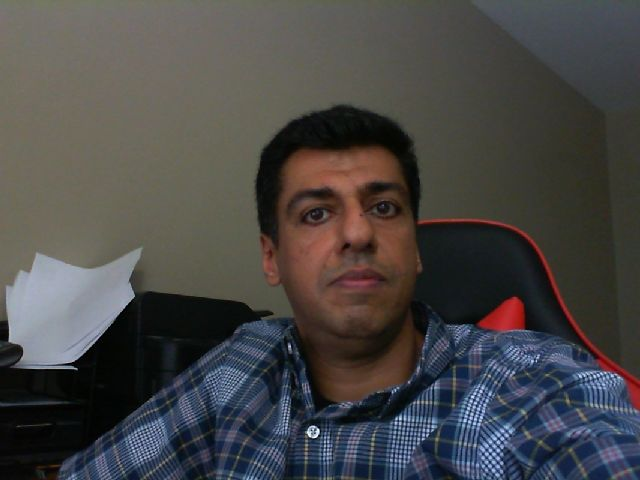

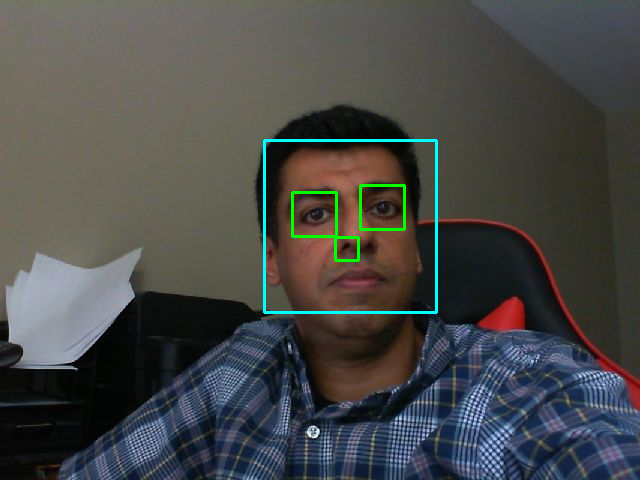

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

face_cascade = cv2.CascadeClassifier("/content/drive/MyDrive/Meta/haarcascade_frontalface_default.xml")
eye_cascade = cv2.CascadeClassifier("/content/drive/MyDrive/Meta/haarcascade_eye.xml")

# Call function and open the camera
image_file = take_photo()

#Show the read image
image = cv2.imread(image_file)
cv2_imshow(image)


#Repeat the above code to detect the face and eyes in your image
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
faces = face_cascade.detectMultiScale(gray, 1.3, 5)

for (x,y,w,h) in faces:
    img1 = cv2.rectangle(image,(x, y),(x + w, y + h),(255,255,0),2)
    roi_gray = gray[y: y + h, x: x + w]
    roi_color = image[y: y + h, x: x + w]
    eyes = eye_cascade.detectMultiScale(roi_gray)
    for (ex, ey, ew, eh) in eyes:
        cv2.rectangle(roi_color,(ex, ey), (ex + ew, ey + eh), (0,255,0),2)

cv2_imshow(image)

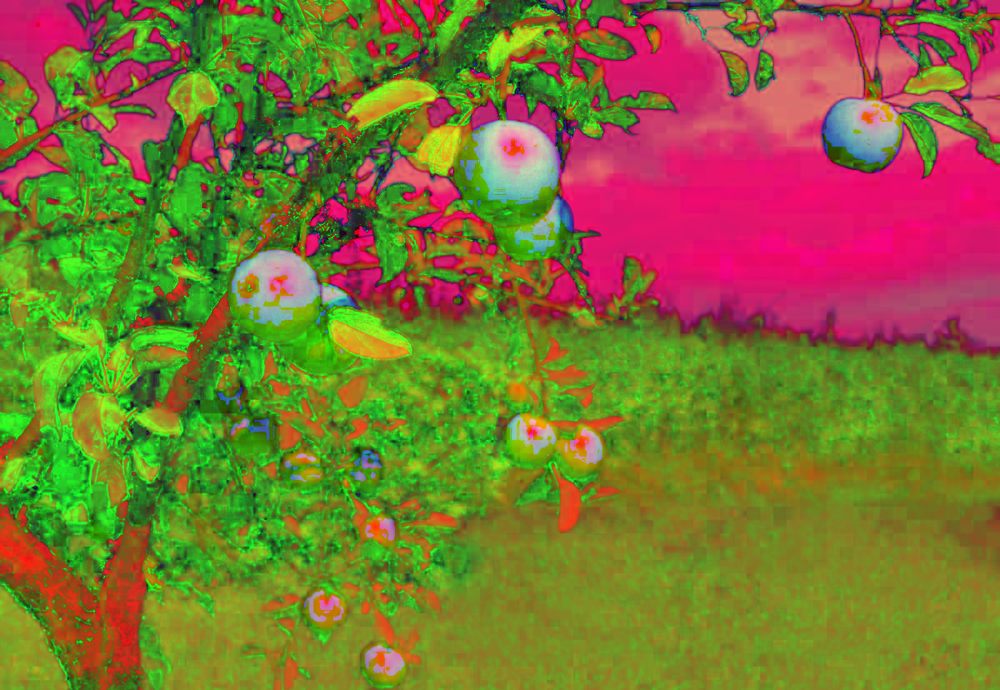

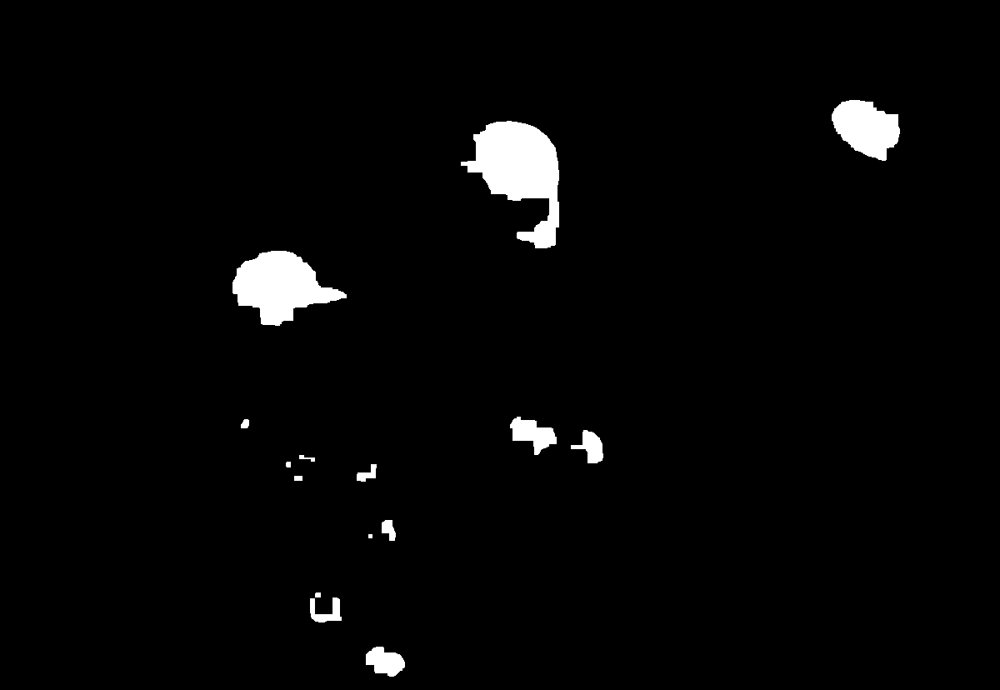

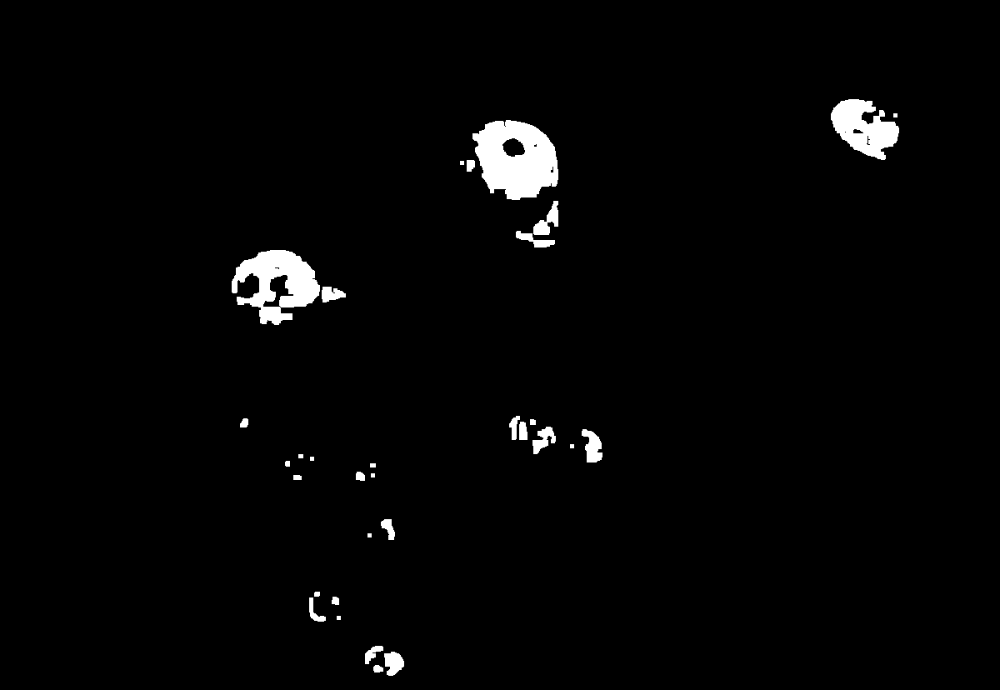

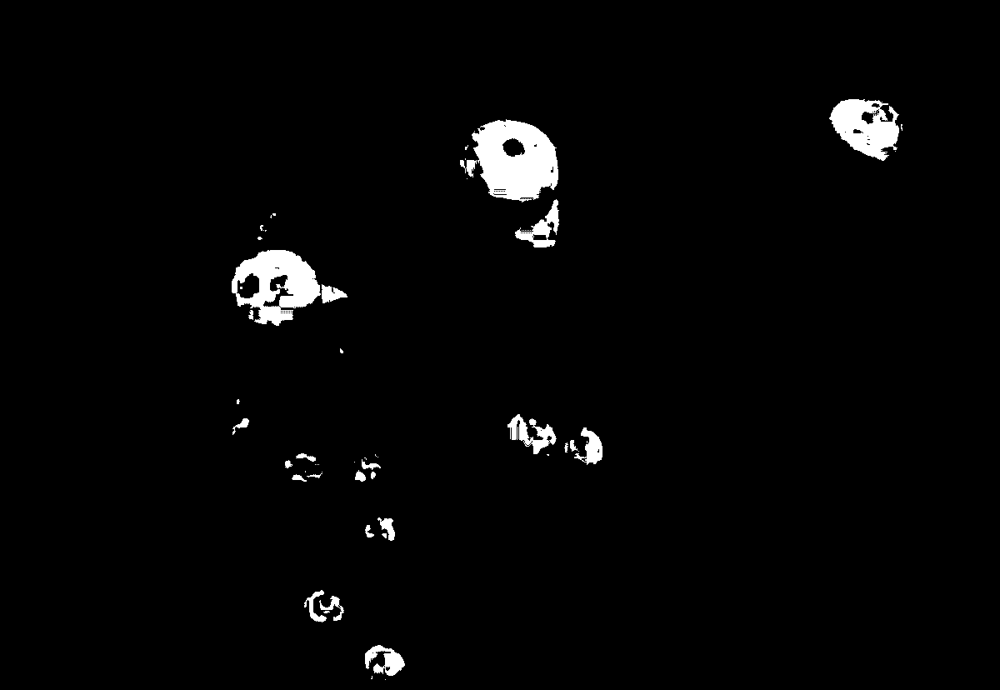

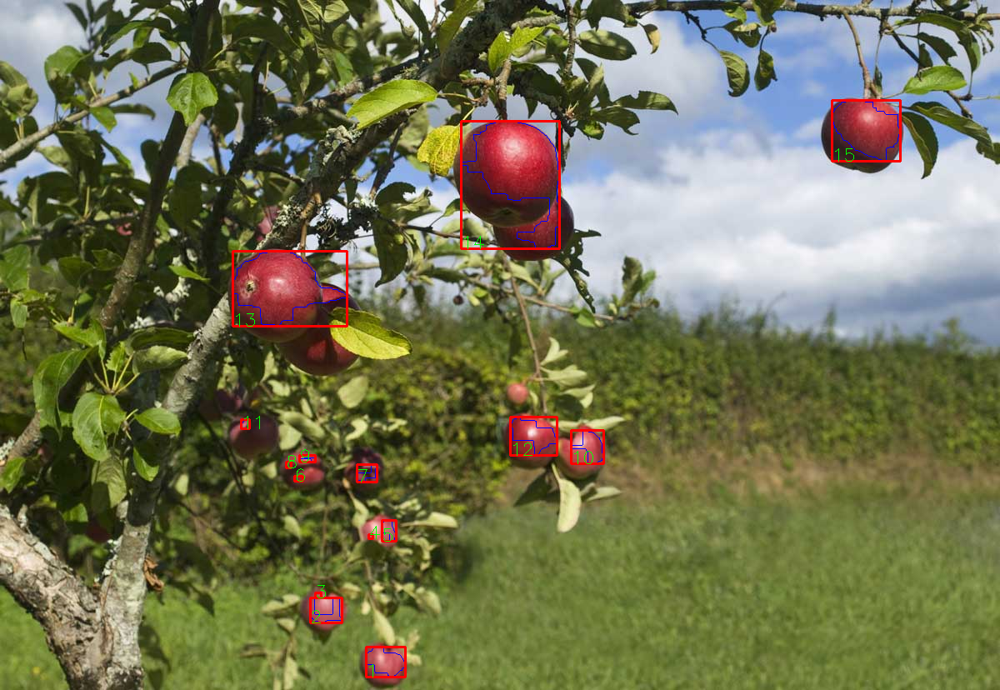

In [ ]:
# Counting using CV
lowerBound=np.array([170,100,80])
upperBound=np.array([180,256,256])

#cam= cv2.VideoCapture(0)
kernelOpen=np.ones((5,5))
kernelClose=np.ones((20,20))

font = cv2.FONT_HERSHEY_SIMPLEX


img=cv2.imread('/content/drive/MyDrive/Meta/apple.jpg')
#img=cv2.resize(img,(340,220))

#convert BGR to HSV
imgHSV= cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
cv2_imshow(imgHSV)
# create the Mask
mask=cv2.inRange(imgHSV,lowerBound,upperBound)
#morphology
maskOpen=cv2.morphologyEx(mask,cv2.MORPH_OPEN,kernelOpen)
maskClose=cv2.morphologyEx(maskOpen,cv2.MORPH_CLOSE,kernelClose)

maskFinal=maskClose
conts,h=cv2.findContours(maskFinal.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)

cv2.drawContours(img,conts,-1,(255,0,0),1)
for i in range(len(conts)):
    x,y,w,h=cv2.boundingRect(conts[i])
    cv2.rectangle(img,(x,y),(x+w,y+h),(0,0,255), 2)
    cv2.putText(img, str(i+1),(x,y+h),cv2.FONT_HERSHEY_SIMPLEX,0.7,(0,255,0))

cv2_imshow(maskClose)
cv2_imshow(maskOpen)
cv2_imshow(mask)
cv2_imshow(img)


In [ ]:
print( 'There were ',len(conts) ,' apples in this picture') #Print number of apples

There were  15  apples in this picture


# Pose Estimation

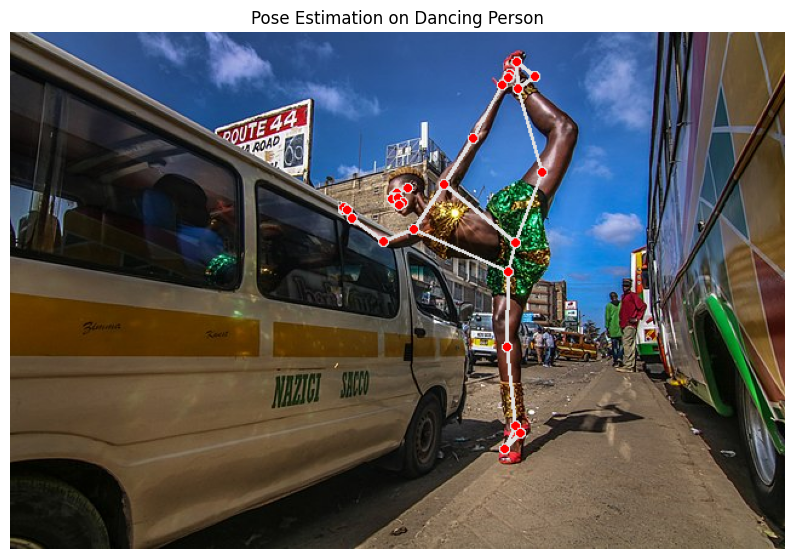

In [ ]:
# Load Image
#image_path = 'https://upload.wikimedia.org/wikipedia/commons/thumb/3/38/Two_dancers.jpg/640px-Two_dancers.jpg'
#!wget {image_path} -O pose_image.jpg
#image = cv2.imread('pose_image.jpg')
#image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

image_url = 'https://upload.wikimedia.org/wikipedia/commons/thumb/8/8a/Dancing_through_Meditation.jpg/640px-Dancing_through_Meditation.jpg'
urllib.request.urlretrieve(image_url, 'dancer.jpg')

image_bgr = cv2.imread('dancer.jpg')
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

# Step 5: Pose estimation
mp_pose = mp.solutions.pose
pose = mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5)
mp_drawing = mp.solutions.drawing_utils

results = pose.process(image_rgb)

# Step 6: Show results
if results.pose_landmarks:
    annotated_image = image_bgr.copy()
    mp_drawing.draw_landmarks(annotated_image, results.pose_landmarks, mp_pose.POSE_CONNECTIONS)
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title("Pose Estimation on Dancing Person")
    plt.show()
else:
    print("No pose landmarks detected.")


# Liveobject detection

In [ ]:
from ultralytics import YOLO
import cv2
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode
import numpy as np
import PIL.Image
import io

In [ ]:
def take_photo(filename='photo.jpg', quality=0.8):
    js = f"""
    async function takePhoto(quality) {{
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({{video: true}});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }}
    takePhoto({quality});
    """
    data = eval_js(js)
    binary = b64decode(data.split(',')[1])
    with open(filename, 'wb') as f:
        f.write(binary)
    return filename

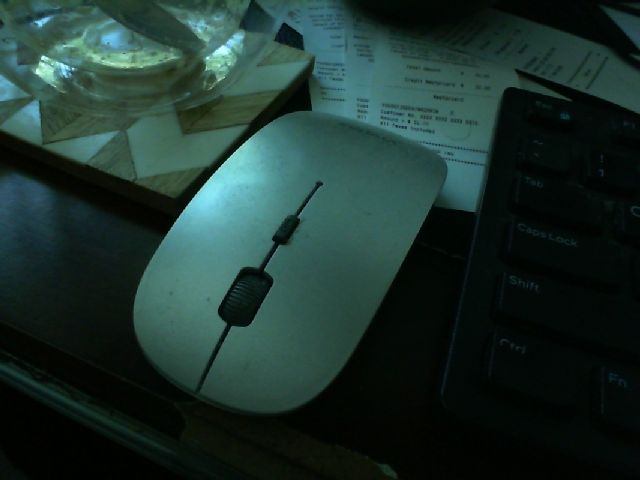


0: 480x640 1 laptop, 1 mouse, 7.2ms
Speed: 1.6ms preprocess, 7.2ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


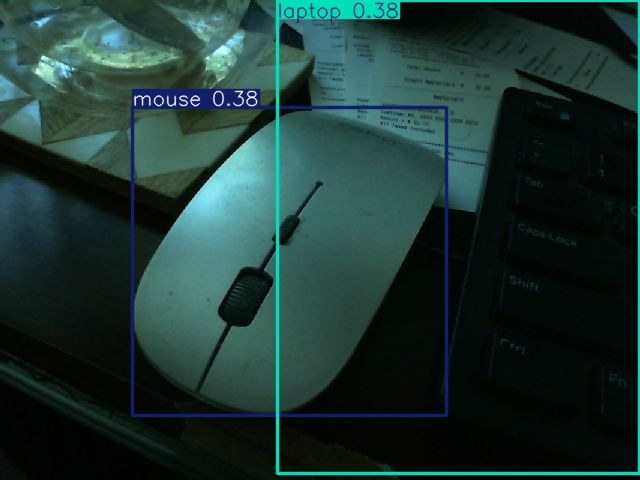

In [ ]:
filename = take_photo()
display(PIL.Image.open(filename))



# Load model
model = YOLO("yolov8n.pt")

# Load image
img = cv2.imread(filename)

# Run detection
results = model(img)

# Plot results
annotated_img = results[0].plot()

# Save and display result
cv2.imwrite("result.jpg", annotated_img)
display(PIL.Image.open("result.jpg"))


**Multi-Modal Models**

**CLIP – Text-Image Embedding and Zero-Shot Classification**

In [ ]:
!pip install -q transformers torchvision accelerate

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 54.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 55.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 25.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 36.0 MB/s eta 0:00:00


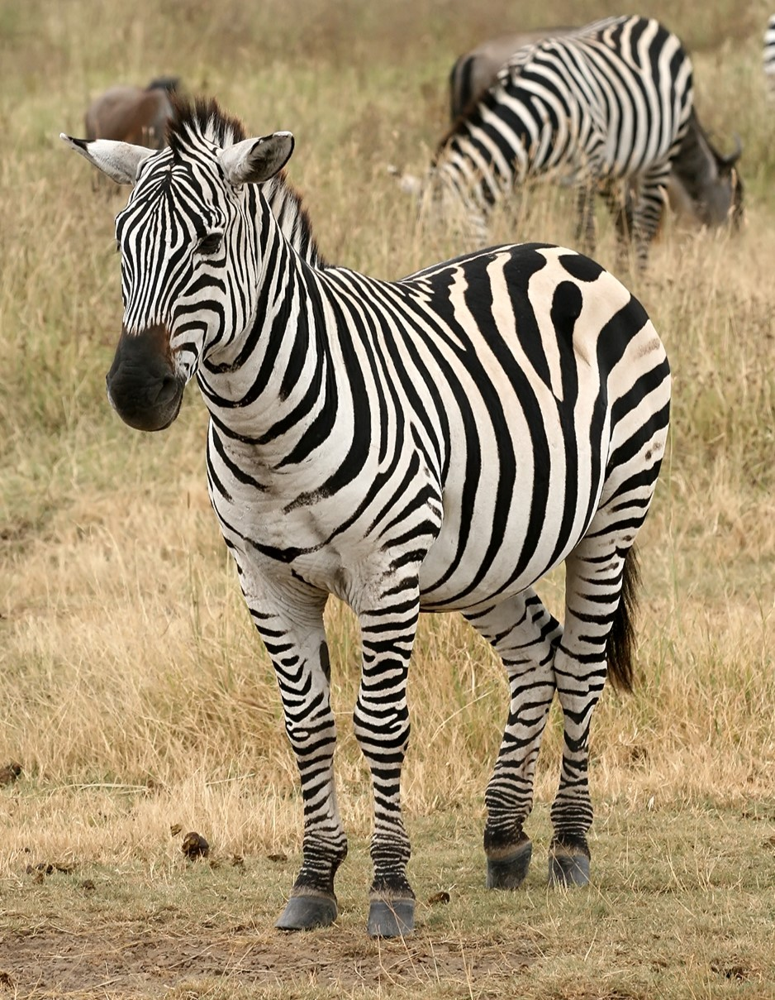

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/605M [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

Predicted label: a photo of a zebra
Probabilities: [[0.9995256662368774, 0.00045618892181664705, 1.8165948858950287e-05]]


In [ ]:
from PIL import Image
import requests
from transformers import CLIPProcessor, CLIPModel
import torch

# Direct image link (JPEG file)
url = "https://upload.wikimedia.org/wikipedia/commons/9/96/Plains_Zebra_Equus_quagga_cropped.jpg"
image = Image.open(requests.get(url, stream=True).raw)
display(image)

# Load model and processor
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

# Define candidate text labels
labels = ["a photo of a zebra", "a photo of a horse", "a photo of a dog"]

# Preprocess inputs
inputs = processor(text=labels, images=image, return_tensors="pt", padding=True)
outputs = model(**inputs)

# Compute similarity and predict
logits_per_image = outputs.logits_per_image
probs = logits_per_image.softmax(dim=1)

# Show results
print("Predicted label:", labels[probs.argmax()])
print("Probabilities:", probs.tolist())

**Text-to-Image Generation**

In [ ]:
!pip install -q diffusers transformers accelerate

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/2880f2ca379f41b0226444936bb7a6766a227587/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/2880f2ca379f41b0226444936bb7a6766a227587/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/2880f2ca379f41b0226444936bb7a6766a227587/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/2880f2ca379f41b0226444936bb7a6766a227587/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


  0%|          | 0/50 [00:00<?, ?it/s]

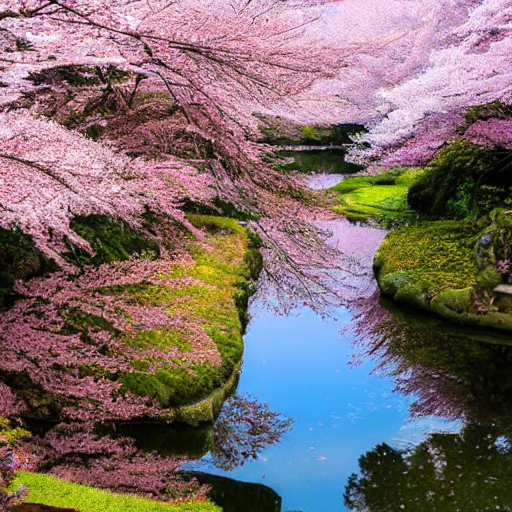

In [ ]:
from diffusers import StableDiffusionPipeline
import torch
from IPython.display import display
from PIL import Image

# Load model
pipe = StableDiffusionPipeline.from_pretrained(
    "CompVis/stable-diffusion-v1-4",
    torch_dtype=torch.float16,
    revision="fp16"
).to("cuda")

# Generate image
prompt = "A piece of nature in Japan with cherry blossom trees and a pond near them"
image2 = pipe(prompt).images[0]

# Display image inline
display(image2)
